<a href="https://colab.research.google.com/github/Omarelfarouk90/Big-data-analytics/blob/main/final_feature_engineering_%2BGBoost%2Bfinal_figures%2Bbig_data_analytics_on_smart_grid_system_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd /content/drive/My Drive/Colab Notebooks/

/content/drive/My Drive/Colab Notebooks


# Current directory

# Pyspark installation

installing the PY spark on the google colab


In [3]:
!pip install pyspark
!pip install -U -q PyDrive
!apt install openjdk-8-jdk-headless -qq
import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 281.4 MB 33 kB/s 
     |████████████████████████████████| 198 kB 59.6 MB/s 
  Created wheel for pyspark: filename=pyspark-3.2.1-py2.py3-none-any.whl size=281853642 sha256=21b927b10e6ba748643e01c2da58a5614fb31d034c0a8e5792991ac8b767dedc
  Stored in directory: /root/.cache/pip/wheels/9f/f5/07/7cd8017084dce4e93e84e92efd1e1d5334db05f2e83bcef74f
Successfully built pyspark
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  openjdk-8-jre-headless
Suggested packages:
  openjdk-8-demo openjdk-8-source libnss-mdns fonts-dejavu-extra
  fonts-ipafont-gothic fonts-ipafont-mincho fonts-wqy-microhei
  fonts-wqy-zenhei fonts-indic
The following NEW packages will be installed:
  openjdk-8-jdk-headless openjdk-8-jre-headless
0 upg

In [4]:
!pip install sagemaker

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 537 kB 5.0 MB/s 
     |████████████████████████████████| 49 kB 4.9 MB/s 
     |████████████████████████████████| 132 kB 67.0 MB/s 
     |████████████████████████████████| 76 kB 5.5 MB/s 
     |████████████████████████████████| 8.8 MB 42.6 MB/s 
     |████████████████████████████████| 79 kB 5.8 MB/s 
     |████████████████████████████████| 138 kB 43.5 MB/s 
     |████████████████████████████████| 52 kB 1.2 MB/s 
  Created wheel for sagemaker: filename=sagemaker-2.93.0-py2.py3-none-any.whl size=740746 sha256=e976fceb759e9bba6dc7dd1fbf303ff85a4bf1f1507b643a1ec4d0d75c1b7424
  Stored in directory: /root/.cache/pip/wheels/48/78/73/20499cca3b9911c65b51bf5651fd4ac417bfe97b09b3072b4d
  Created wheel for protobuf3-to-dict: filename=protobuf3_to_dict-0.1.5-py3-none-any.whl size=4030 sha256=b0617839c4ef4a10243af69b43a40caccba63cd53687674c5c243df14fac6e93
  Stor

importing the essential python libraries, such as pandas, numpy and matplotlib

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import pyspark
from pyspark.sql import *
from pyspark.sql.types import *
from pyspark.sql.functions import *
from pyspark import SparkContext, SparkConf



# Data pipeline creation

creating the datapipeline by adding a port using apache spark

In [6]:
# create the session
conf = SparkConf().set("spark.ui.port", "4050")

# create the context
sc = pyspark.SparkContext(conf=conf)
spark = SparkSession.builder.getOrCreate()

calling the spark session to see more details about the datapipeline


In [7]:
spark

# importing the smart grid dataset

reading the smart grid stability dataset on the `PySpark` 

In [10]:
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import LinearRegression
from pyspark.ml import Pipeline
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.feature import StringIndexer, VectorIndexer
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
dataset = spark.read.csv('/content/smart_grid_stability_augmented.csv',inferSchema=True, header =True)

#dataset = spark.read.csv('/content/drive/My Drive/smart_grid_stability_augmented.csv',inferSchema=True, header =True)



getting  information about the dataset

In [11]:
print('Column Names', dataset.columns, '\n\n')

Column Names ['tau1', 'tau2', 'tau3', 'tau4', 'p1', 'p2', 'p3', 'p4', 'g1', 'g2', 'g3', 'g4', 'stab', 'stabf'] 




In [12]:
dataset.count()

60000

In [13]:
dataset.head(2)

[Row(tau1=2.95906002455997, tau2=3.07988520422811, tau3=8.38102539191882, tau4=9.78075443222607, p1=3.76308477206316, p2=-0.782603630987543, p3=-1.25739482958732, p4=-1.7230863114883, g1=0.650456460887227, g2=0.859578105752345, g3=0.887444920638513, g4=0.958033987602737, stab=0.055347489172775, stabf='unstable'),
 Row(tau1=9.3040972346785, tau2=4.90252411201167, tau3=3.04754072762177, tau4=1.36935735529605, p1=5.06781210427845, p2=-1.94005842705193, p3=-1.87274168559721, p4=-1.25501199162931, g1=0.41344056837935, g2=0.862414076352903, g3=0.562139050527675, g4=0.781759910653126, stab=-0.005957464326037, stabf='stable')]

coverting input values to vectors for the machinne learning model

In [14]:
vectorAssembler = VectorAssembler(inputCols = ['tau1', 'tau2', 'tau3', 'tau4', 'p1', 'p2', 'p3', 'p4', 'g1', 'g2', 'g3', 'g4']\
                                  , outputCol = 'features')


Create feature engineering to extract the important parameters in the data

# Feature engineering

Vector assembler is used in the feature engineering where it adds all the features into a single vector, so far all the features considered are reaction time of supply and 3 consumers, power balance for the supply and 3 customers, and price elasticity for the supply and the 3 consumers, and neither a single feature can be neglected

In [15]:
v_grid_df = vectorAssembler.transform(dataset)


In [16]:
vgrid_df = v_grid_df.select(['features', 'stab'])

Applying standardization and normalization for continuous dataset

In [17]:
v_grid_df5 = vectorAssembler.transform(dataset)

In [18]:
vgrid_df6 = v_grid_df5.select(['features', 'stab'])

features are standardized with mean of zero and variance of 1

In [19]:
from pyspark.ml.feature import StandardScaler
Scalerizer=StandardScaler().setInputCol("features").setOutputCol("Scaled_features")
Scalerizer.fit(v_grid_df5).transform(v_grid_df5).show()

+-----------------+----------------+-----------------+----------------+----------------+------------------+------------------+------------------+-----------------+-----------------+-----------------+-----------------+------------------+--------+--------------------+--------------------+
|             tau1|            tau2|             tau3|            tau4|              p1|                p2|                p3|                p4|               g1|               g2|               g3|               g4|              stab|   stabf|            features|     Scaled_features|
+-----------------+----------------+-----------------+----------------+----------------+------------------+------------------+------------------+-----------------+-----------------+-----------------+-----------------+------------------+--------+--------------------+--------------------+
| 2.95906002455997|3.07988520422811| 8.38102539191882|9.78075443222607|3.76308477206316|-0.782603630987543| -1.25739482958732|  -1.72308

In [20]:
vgrid_df7 =Scalerizer.fit(v_grid_df5).transform(v_grid_df5)

In [21]:
vgrid_df7

DataFrame[tau1: double, tau2: double, tau3: double, tau4: double, p1: double, p2: double, p3: double, p4: double, g1: double, g2: double, g3: double, g4: double, stab: double, stabf: string, features: vector, Scaled_features: vector]

In [22]:
vgrid_df7 = vgrid_df7.select(['Scaled_features', 'stab'])

Normalization of the standardized data

the data is normalized in order to calculate the distance between featueres. the calculation is performed either by manhatin distance or euclidean distance

In [23]:
from pyspark.ml.feature import Normalizer
l1_norm=Normalizer().setP(1).setInputCol("features").setOutputCol("l1_norm")
l2_norm=Normalizer().setP(2).setInputCol("features").setOutputCol("l2_norm")
linf_norm=Normalizer().setP(float("inf")).setInputCol("features").setOutputCol("linf_norm")
# Let us transform
l1_norm.transform(v_grid_df5).show(truncate=False)

+-----------------+----------------+-----------------+----------------+----------------+------------------+------------------+------------------+-----------------+-----------------+-----------------+-----------------+------------------+--------+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|tau1             |tau2            |tau3             |tau4            |p1              |p2                |p3                |p4                |g1               |g2               |g3               |g4               |stab              |stabf   |features                                   

In [24]:
vgrid_df8 =l1_norm.transform(v_grid_df5)

In [25]:
vgrid_df8 = vgrid_df8.select(['l1_norm', 'stab'])

# Applying penalized regression model

Using `PYSpark` for training penalized regression models on large smart grid dataset

performing the split of data for reduction and identifying the accuracy of the machine learning model


we will start the machine learning using the regression model with `stab` column 

RMS Error                      alpha
0.03589154252018955 1.0
0.03065103593667738 0.1
0.02283171557589705 0.010000000000000002
0.022008036637969203 0.0010000000000000002
0.02199657281840603 0.00010000000000000002
0.021996592663620276 1.0000000000000003e-05
0.021996606938108967 1.0000000000000004e-06


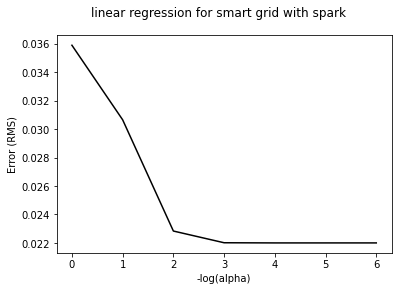

In [26]:
splits = vgrid_df.randomSplit([0.66, 0.34])
xTrain_sp = splits[0]
xTest_sp = splits[1]
alphaList = [0.1**i for i in [0,1, 2, 3, 4, 5, 6]]
rmsError = []
for alph in alphaList:
  grid_ridge_sp = LinearRegression(featuresCol = 'features', \
                                  labelCol='stab', maxIter=100, regParam=alph, \
                                  elasticNetParam=0.0)
  grid_ridge_sp_model = grid_ridge_sp.fit(xTrain_sp)
  test_result = grid_ridge_sp_model.evaluate(xTest_sp)
  rmsError.append(test_result.rootMeanSquaredError)
print('{:30}'.format("RMS Error"), "alpha")
for i in range(len(rmsError)):
 print(rmsError[i], alphaList[i])
#plot curve of out-of-sample error versus alpha
x = range(len(rmsError))
plt.plot(x, rmsError, 'k')
plt.xlabel('-log(alpha)')
plt.ylabel('Error (RMS)')
plt.suptitle('linear regression for smart grid with spark')
plt.savefig('linear_regression_for_smart_grid_with_spark.png', dpi=500)
plt.show()

In [27]:
from pyspark.sql import functions as F
from pyspark.ml.feature import OneHotEncoder, StringIndexer, VectorAssembler
from pyspark.ml.feature import CountVectorizer
from pyspark.ml.tuning import ParamGridBuilder
from pyspark.ml.evaluation import BinaryClassificationEvaluator
import numpy as np
from pyspark.ml.tuning import CrossValidator
import plotly.graph_objects as go
df=spark.read.csv('/content/drive/My Drive/smart_grid_stability_augmented.csv',inferSchema=True, header =True)
df.count()
len(df.columns)

14

In [28]:
df = df.withColumn("label",
  expr("case when stabf = 'stable' then '1' " +
                   "else '0' end"))

In [29]:
df.withColumn("label",col("label").cast("INT"))

DataFrame[tau1: double, tau2: double, tau3: double, tau4: double, p1: double, p2: double, p3: double, p4: double, g1: double, g2: double, g3: double, g4: double, stab: double, stabf: string, label: int]

In [30]:
from pyspark.sql.types import IntegerType
df = df.withColumn("label", df["label"].cast(IntegerType()))

In [31]:
df.describe().toPandas().transpose()

,0,1,2,3,4
summary,count,mean,stddev,min,max
tau1,60000,5.249999930614229,2.7424340969998022,0.500793021360319,9.99946946943287
tau2,60000,5.250000536852691,2.742436943176698,0.500141360493773,9.99983655621537
tau3,60000,5.250000536852734,2.742436943176694,0.500141360493773,9.99983655621537
tau4,60000,5.250000536852706,2.742436943176687,0.500141360493773,9.99983655621537
p1,60000,3.7499999579361525,0.7521287637246865,1.58258966481528,5.8644179596283
p2,60000,-1.2499999859787214,0.43301693634416083,-1.99994466917731,-0.500024528740323
p3,60000,-1.2499999859787223,0.43301693634416083,-1.99994466917731,-0.500024528740323
p4,60000,-1.24999998597873,0.4330169363441612,-1.99994466917731,-0.500024528740323
g1,60000,0.524999788849209,0.2742441042086806,0.050009303611129,0.999937073063054


Pie chart of target varaibles

In [32]:
df2=df.toPandas()
df22=df2.groupby('label').count().reset_index()[['label','stabf']].rename(columns={'stabf':'counts'})
colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']
fig = go.Figure(data=[go.Pie(labels=df22.label,
                             values=df22.counts)])
fig.update_traces(hoverinfo='label+percent', textinfo='value+percent', textfont_size=20, textfont_color='black',
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))
# fig.show()
fig.update_layout(title='stable vs unstable smart grid', title_x=0.5)

Feature variable histogram

In [33]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=4, cols=4, start_cell="top-left",
                   subplot_titles=df2.columns[:-1])
fig.add_trace(go.Histogram(x=df2.tau1, name='tau1'),
              row=1, col=1)
fig.add_trace(go.Histogram(x=df2.tau2, name='tau2'),
              row=1, col=2)
fig.add_trace(go.Histogram(x=df2.tau3, name='tau3'),
              row=1, col=3)
fig.add_trace(go.Histogram(x=df2.tau3, name='tau4'),
              row=1, col=4)
fig.add_trace(go.Histogram(x=df2.p1, name='p1'),
              row=2, col=1)
fig.add_trace(go.Histogram(x=df2.p2, name='p2'),
              row=2, col=2)
fig.add_trace(go.Histogram(x=df2.p3, name='p3'),
              row=2, col=3)
fig.add_trace(go.Histogram(x=df2.p4, name='p4'),
              row=2, col=4)
fig.add_trace(go.Histogram(x=df2.g1, name='g1'),
              row=3, col=1)
fig.add_trace(go.Histogram(x=df2.g2, name='g2'),
              row=3, col=2)
fig.add_trace(go.Histogram(x=df2.g3, name='g3'),
              row=3, col=3)
fig.add_trace(go.Histogram(x=df2.g4, name='g4'),
              row=3, col=4)
fig.add_trace(go.Histogram(x=df2.stab, name='stab'),
              row=4, col=1)
fig.add_trace(go.Histogram(x=df2.stabf, name='stabf'),
              row=4, col=2)
fig.update_layout(title='Histograms of Variables', title_x=0.5)

Transforming non-normal distributed dataset

In [34]:
df3=df.withColumn('tau4log', F.log(df['tau4']+1))
df33=df3.toPandas()
fig = make_subplots(rows=1, cols=2, start_cell="top-left",
                   subplot_titles=['tau4','tau4log'])
fig.add_trace(go.Histogram(x=df33.tau4, name='tau4'),
              row=1, col=1)
fig.add_trace(go.Histogram(x=df33.tau4, name='tau4log'),
              row=1, col=2)
fig.update_layout(title='Transforming tau4', title_x=0.5)

Correlation matrix creation

In [35]:
corr = df33.corr()
fig = go.Figure(data=go.Heatmap(z=corr.values,
 x=corr.index.values,
 y=corr.columns.values,
 text=np.round(corr.values,2),
 texttemplate= "%{text}"))
fig.update_layout(title=dict(text='Correlation Matrix Heatmap',font=dict(size=20), x=0.5))

In [36]:
#Initialize stages
stages = []
#Target column
label_stringIdx = StringIndexer(inputCol = 'label', outputCol = 'label2')
stages += [label_stringIdx]
#Numeric Columns
numericCols = ['tau1',
 'tau2',
 'tau3',
 'tau4',
 'p1',
 'p2',
 'p3',
 'p4',
 'g1',
 'g2',
 'g3',
 'g4',
 'tau4log'] 
#Create a vector assembler
assemblerInputs = numericCols 
assembler = VectorAssembler(inputCols=assemblerInputs, outputCol="features").setHandleInvalid('keep')
stages += [assembler]

In [37]:
from pyspark.ml import Pipeline
pipeline = Pipeline(stages = stages)
pipelineModel = pipeline.fit(df3)
df3 = pipelineModel.transform(df3)
selectedCols = ['label2', 'features'] +  ['tau1',
 'tau2',
 'tau3',
 'tau4',
 'p1',
 'p2',
 'p3',
 'p4',
 'g1',
 'g2',
 'g3',
 'g4',
 'tau4log','label']
df3 = df3.select(selectedCols)
df3.printSchema()

root
 |-- label2: double (nullable = false)
 |-- features: vector (nullable = true)
 |-- tau1: double (nullable = true)
 |-- tau2: double (nullable = true)
 |-- tau3: double (nullable = true)
 |-- tau4: double (nullable = true)
 |-- p1: double (nullable = true)
 |-- p2: double (nullable = true)
 |-- p3: double (nullable = true)
 |-- p4: double (nullable = true)
 |-- g1: double (nullable = true)
 |-- g2: double (nullable = true)
 |-- g3: double (nullable = true)
 |-- g4: double (nullable = true)
 |-- tau4log: double (nullable = true)
 |-- label: integer (nullable = true)



In [38]:
train, test = df3.randomSplit([0.6, 0.4], seed = 2018)

In [39]:
# import xgboost
import xgboost as xgb

In [40]:
from sklearn.model_selection import train_test_split, GridSearchCV

In [41]:
from pyspark.ml import Pipeline
from pyspark.ml.classification import GBTClassifier
from pyspark.ml.feature import StringIndexer, VectorIndexer
from pyspark.ml.evaluation import MulticlassClassificationEvaluator


In [47]:
from pyspark.ml.regression import GeneralizedLinearRegression
glr = GeneralizedLinearRegression(family="gaussian", link="identity", maxIter=10, regParam=0.3)

# Fit the model
model = glr.fit(train)

# Print the coefficients and intercept for generalized linear regression model
print("Coefficients: " + str(model.coefficients))
print("Intercept: " + str(model.intercept))

# Summarize the model over the training set and print out some metrics
summary = model.summary
print("Coefficient Standard Errors: " + str(summary.coefficientStandardErrors))
print("T Values: " + str(summary.tValues))
print("P Values: " + str(summary.pValues))
print("Dispersion: " + str(summary.dispersion))
print("Null Deviance: " + str(summary.nullDeviance))
print("Residual Degree Of Freedom Null: " + str(summary.residualDegreeOfFreedomNull))
print("Deviance: " + str(summary.deviance))
print("Residual Degree Of Freedom: " + str(summary.residualDegreeOfFreedom))
print("AIC: " + str(summary.aic))
print("Deviance Residuals: ")
summary.residuals().show()

Coefficients: [-0.02491237626464347,-0.02563856964354149,-0.02596552785563207,-0.013079206123183088,-8.362089836999928e-05,8.368724829650518e-05,0.00041358624142170155,-0.00024282243435284472,-0.21184976318412363,-0.23141744980682075,-0.2312142252794511,-0.23140402415186234,-0.10916441519941364]
Intercept: 1.494069944883066
Coefficient Standard Errors: [0.0005791015061412967, 0.0005793295732287485, 0.000580489934421536, 0.0007236737428840657, 0.002678142422803007, 0.00402815614759658, 0.004026644088938378, 0.00402296556272416, 0.005792835030549244, 0.005795275515515024, 0.005803714128399385, 0.005795646035939466, 0.00378521902306527, 0.013102029984865163]
T Values: [-43.019014802156335, -44.25558581560291, -44.73036708467129, -18.073346244480796, -0.031223469542922842, 0.020775572055824504, 0.10271239083629646, -0.06035906362281088, -36.570998840275486, -39.93208764402546, -39.83901001395774, -39.927218245714016, -28.839656182170486, 114.03347012706764]
P Values: [0.0, 0.0, 0.0, 0.0, 0

/usr/local/lib/python3.7/dist-packages/pyspark/sql/context.py:127: FutureWarning:

Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.



+--------------------+
|   devianceResiduals|
+--------------------+
|-0.24747754273952238|
|-0.24771503172343023|
| -0.2533626254520054|
| -0.3629987842766651|
|-0.36110165064015365|
|-0.36061037192017076|
| -0.4880884739114224|
| -0.5159770691654634|
|-0.19496447189642674|
| -0.4647700171760203|
| -0.4703197981508278|
|-0.47114800198327433|
|  -0.516242513506604|
| -0.5170151870544328|
| -0.5170319473301273|
|-0.36536803255433914|
| -0.3707689690306841|
| -0.3939477145623955|
| -0.3953198224223531|
| -0.4316767474196579|
+--------------------+
only showing top 20 rows



In [48]:
model.summary

Coefficients:
    Feature Estimate Std Error  T Value P Value
(Intercept)   1.4941    0.0131 114.0335  0.0000
       tau1  -0.0249    0.0006 -43.0190  0.0000
       tau2  -0.0256    0.0006 -44.2556  0.0000
       tau3  -0.0260    0.0006 -44.7304  0.0000
       tau4  -0.0131    0.0007 -18.0733  0.0000
         p1  -0.0001    0.0027  -0.0312  0.9751
         p2   0.0001    0.0040   0.0208  0.9834
         p3   0.0004    0.0040   0.1027  0.9182
         p4  -0.0002    0.0040  -0.0604  0.9519
         g1  -0.2118    0.0058 -36.5710  0.0000
         g2  -0.2314    0.0058 -39.9321  0.0000
         g3  -0.2312    0.0058 -39.8390  0.0000
         g4  -0.2314    0.0058 -39.9272  0.0000
    tau4log  -0.1092    0.0038 -28.8397  0.0000

(Dispersion parameter for gaussian family taken to be 0.1481)
    Null deviance: 8308.4576 on 36034 degrees of freedom
Residual deviance: 5337.0792 on 36034 degrees of freedom
AIC: 33471.8816

In [49]:
vectorAssembler2 = VectorAssembler(inputCols = ['tau1', 'tau2', 'tau3', 'tau4', 'g1', 'g2', 'g3', 'g4']\
                                  , outputCol = 'features')


In [50]:
v_grid_df9 = vectorAssembler2.transform(dataset)


In [51]:
vgrid_df10 = v_grid_df9.select(['features', 'stab'])

RMS Error                      alpha
0.03616220397868542 1.0
0.030884847881148935 0.1
0.0228246745726884 0.010000000000000002
0.0219149701436352 0.0010000000000000002
0.021895595625375464 0.00010000000000000002
0.021894852916417847 1.0000000000000003e-05
0.021894791254559422 1.0000000000000004e-06


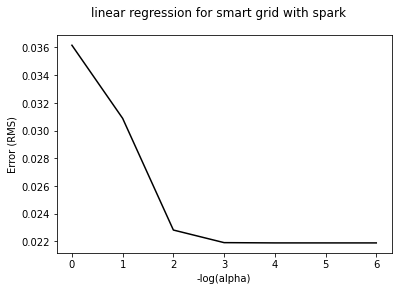

In [52]:
splits = vgrid_df10.randomSplit([0.66, 0.34])
xTrain_sp = splits[0]
xTest_sp = splits[1]
alphaList = [0.1**i for i in [0,1, 2, 3, 4, 5, 6]]
rmsError = []
for alph in alphaList:
  grid_ridge_sp = LinearRegression(featuresCol = 'features', \
                                  labelCol='stab', maxIter=100, regParam=alph, \
                                  elasticNetParam=0.0)
  grid_ridge_sp_model = grid_ridge_sp.fit(xTrain_sp)
  test_result = grid_ridge_sp_model.evaluate(xTest_sp)
  rmsError.append(test_result.rootMeanSquaredError)
print('{:30}'.format("RMS Error"), "alpha")
for i in range(len(rmsError)):
 print(rmsError[i], alphaList[i])
#plot curve of out-of-sample error versus alpha
x = range(len(rmsError))
plt.plot(x, rmsError, 'k')
plt.xlabel('-log(alpha)')
plt.ylabel('Error (RMS)')
plt.suptitle('linear regression for smart grid with spark')
plt.savefig('linear_regression_for_smart_grid_with_spark.png', dpi=500)
plt.show()

Calculating the error after standardization and normalization

RMS Error                      alpha
0.03613293689823744 1.0
0.03085394594431718 0.1
0.02286283313380213 0.010000000000000002
0.02202724846442789 0.0010000000000000002
0.02201930478721869 0.00010000000000000002
0.022019758827083603 1.0000000000000003e-05
0.022019817392474193 1.0000000000000004e-06


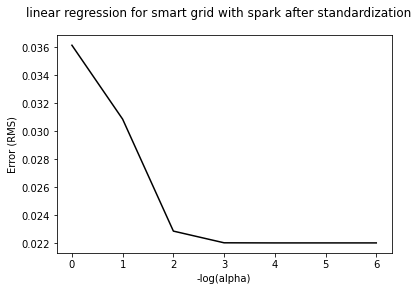

In [53]:
splits = vgrid_df7.randomSplit([0.66, 0.34])
xTrain_sp = splits[0]
xTest_sp = splits[1]
alphaList = [0.1**i for i in [0,1, 2, 3, 4, 5, 6]]
rmsError = []
for alph in alphaList:
  grid_ridge_sp = LinearRegression(featuresCol = 'Scaled_features', \
                                  labelCol='stab', maxIter=100, regParam=alph, \
                                  elasticNetParam=0.0)
  grid_ridge_sp_model = grid_ridge_sp.fit(xTrain_sp)
  test_result = grid_ridge_sp_model.evaluate(xTest_sp)
  rmsError.append(test_result.rootMeanSquaredError)
print('{:30}'.format("RMS Error"), "alpha")
for i in range(len(rmsError)):
 print(rmsError[i], alphaList[i])
#plot curve of out-of-sample error versus alpha
x = range(len(rmsError))
plt.plot(x, rmsError, 'k')
plt.xlabel('-log(alpha)')
plt.ylabel('Error (RMS)')
plt.suptitle('linear regression for smart grid with spark after standardization')
plt.savefig('linear_regression_for_smart_grid_with_spark.png', dpi=500)
plt.show()

Calculating error after normalization

RMS Error                      alpha
0.03628188577020836 1.0
0.03355960064221478 0.1
0.03142735838234586 0.010000000000000002
0.03127756917070745 0.0010000000000000002
0.03127551015033727 0.00010000000000000002
0.031275501262781905 1.0000000000000003e-05
0.03127550243747083 1.0000000000000004e-06


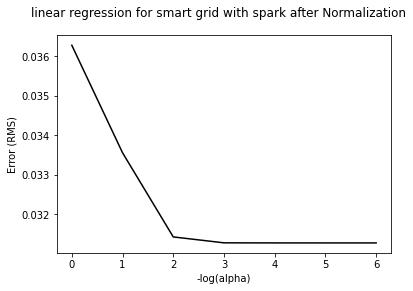

In [54]:
splits = vgrid_df8.randomSplit([0.66, 0.34])
xTrain_sp = splits[0]
xTest_sp = splits[1]
alphaList = [0.1**i for i in [0,1, 2, 3, 4, 5, 6]]
rmsError = []
for alph in alphaList:
  grid_ridge_sp = LinearRegression(featuresCol = 'l1_norm', \
                                  labelCol='stab', maxIter=100, regParam=alph, \
                                  elasticNetParam=0.0)
  grid_ridge_sp_model = grid_ridge_sp.fit(xTrain_sp)
  test_result = grid_ridge_sp_model.evaluate(xTest_sp)
  rmsError.append(test_result.rootMeanSquaredError)
print('{:30}'.format("RMS Error"), "alpha")
for i in range(len(rmsError)):
 print(rmsError[i], alphaList[i])
#plot curve of out-of-sample error versus alpha
x = range(len(rmsError))
plt.plot(x, rmsError, 'k')
plt.xlabel('-log(alpha)')
plt.ylabel('Error (RMS)')
plt.suptitle('linear regression for smart grid with spark after Normalization')
plt.savefig('linear_regression_for_smart_grid_with_spark.png', dpi=500)
plt.show()

# Applying a classification model 

adding a user defined function for stability classification and data wrangling `stabf` to integer

In [55]:


valdf3 = dataset.withColumn("stabint",
  expr("case when stabf = 'stable' then '1' " +
                   "else '0' end"))



In [56]:
valdf3.head(2)

[Row(tau1=2.95906002455997, tau2=3.07988520422811, tau3=8.38102539191882, tau4=9.78075443222607, p1=3.76308477206316, p2=-0.782603630987543, p3=-1.25739482958732, p4=-1.7230863114883, g1=0.650456460887227, g2=0.859578105752345, g3=0.887444920638513, g4=0.958033987602737, stab=0.055347489172775, stabf='unstable', stabint='0'),
 Row(tau1=9.3040972346785, tau2=4.90252411201167, tau3=3.04754072762177, tau4=1.36935735529605, p1=5.06781210427845, p2=-1.94005842705193, p3=-1.87274168559721, p4=-1.25501199162931, g1=0.41344056837935, g2=0.862414076352903, g3=0.562139050527675, g4=0.781759910653126, stab=-0.005957464326037, stabf='stable', stabint='1')]

In [57]:
valdf3.summary().show()

+-------+------------------+-----------------+-----------------+-----------------+------------------+-------------------+-------------------+------------------+------------------+-------------------+-------------------+------------------+--------------------+--------+-------------------+
|summary|              tau1|             tau2|             tau3|             tau4|                p1|                 p2|                 p3|                p4|                g1|                 g2|                 g3|                g4|                stab|   stabf|            stabint|
+-------+------------------+-----------------+-----------------+-----------------+------------------+-------------------+-------------------+------------------+------------------+-------------------+-------------------+------------------+--------------------+--------+-------------------+
|  count|             60000|            60000|            60000|            60000|             60000|              60000|            

In [58]:
print('Column Names', valdf3.columns, '\n\n')

Column Names ['tau1', 'tau2', 'tau3', 'tau4', 'p1', 'p2', 'p3', 'p4', 'g1', 'g2', 'g3', 'g4', 'stab', 'stabf', 'stabint'] 




convert the string to integer

In [59]:
valdf3.withColumn("stabint",col("stabint").cast("INT"))

DataFrame[tau1: double, tau2: double, tau3: double, tau4: double, p1: double, p2: double, p3: double, p4: double, g1: double, g2: double, g3: double, g4: double, stab: double, stabf: string, stabint: int]

In [60]:
from pyspark.sql.types import IntegerType
valdf4 = valdf3.withColumn("stabint", valdf3["stabint"].cast(IntegerType()))


In [61]:
valdf4.printSchema()
valdf4.show()

root
 |-- tau1: double (nullable = true)
 |-- tau2: double (nullable = true)
 |-- tau3: double (nullable = true)
 |-- tau4: double (nullable = true)
 |-- p1: double (nullable = true)
 |-- p2: double (nullable = true)
 |-- p3: double (nullable = true)
 |-- p4: double (nullable = true)
 |-- g1: double (nullable = true)
 |-- g2: double (nullable = true)
 |-- g3: double (nullable = true)
 |-- g4: double (nullable = true)
 |-- stab: double (nullable = true)
 |-- stabf: string (nullable = true)
 |-- stabint: integer (nullable = true)

+-----------------+----------------+-----------------+----------------+----------------+------------------+------------------+------------------+-----------------+-----------------+-----------------+-----------------+------------------+--------+-------+
|             tau1|            tau2|             tau3|            tau4|              p1|                p2|                p3|                p4|               g1|               g2|               g3|            

implementing the classification algorithm and identifying it's accuracy

implementing the classification model on `stabint` column


In [62]:
vectorAssembler = VectorAssembler(inputCols = ['tau1', 'tau2', 'tau3', 'tau4', 'p1', 'p2', 'p3', 'p4', 'g1', 'g2', 'g3', 'g4']\
                                  , outputCol ='features')
v_grid_df2 = vectorAssembler.transform(valdf4)


In [63]:
v_grid_df2.show()

+-----------------+----------------+-----------------+----------------+----------------+------------------+------------------+------------------+-----------------+-----------------+-----------------+-----------------+------------------+--------+-------+--------------------+
|             tau1|            tau2|             tau3|            tau4|              p1|                p2|                p3|                p4|               g1|               g2|               g3|               g4|              stab|   stabf|stabint|            features|
+-----------------+----------------+-----------------+----------------+----------------+------------------+------------------+------------------+-----------------+-----------------+-----------------+-----------------+------------------+--------+-------+--------------------+
| 2.95906002455997|3.07988520422811| 8.38102539191882|9.78075443222607|3.76308477206316|-0.782603630987543| -1.25739482958732|  -1.7230863114883|0.650456460887227|0.8595781057

In [64]:
vgrid_df2 = v_grid_df2.select(['features', 'stabint'])


In [65]:
(training_data, test_data) = vgrid_df2.randomSplit([0.6,0.4], seed =2020)
print("Training Dataset Count: " + str(training_data.count()))
print("Test Dataset Count: " + str(test_data.count()))

Training Dataset Count: 36128
Test Dataset Count: 23872


In [66]:
from pyspark.ml.classification import RandomForestClassifier

rf = RandomForestClassifier(labelCol='stabint', 
                            featuresCol='features',
                            maxDepth=5)


In [67]:
model = rf.fit(training_data)
rf_predictions = model.transform(test_data)

In [68]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

multi_evaluator = MulticlassClassificationEvaluator(labelCol = 'stabint', metricName = 'accuracy')
print('Random Forest classifier Accuracy:', multi_evaluator.evaluate(rf_predictions))

Random Forest classifier Accuracy: 0.8448391420911529


In [69]:
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.feature import StringIndexer, VectorIndexer
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.ml import Pipeline

# Split the data into training and test sets (40% held out for testing)
(trainingData, testData) = vgrid_df2.randomSplit([0.6, 0.4])

# Train a DecisionTree model.
dt = DecisionTreeClassifier(labelCol="stabint", featuresCol="features")

# Chain indexers and tree in a Pipeline
pipeline = Pipeline(stages=[dt])


In [70]:
# Train model.  This also runs the indexers.
model = pipeline.fit(trainingData)


In [71]:

# Make predictions.
predictions = model.transform(testData)

# Select example rows to display.
predictions.select("prediction", "stabint", "features").show(5)

# Select (prediction,stabint) and compute test error
multi_evaluator = MulticlassClassificationEvaluator(
    labelCol="stabint", predictionCol="prediction", metricName="accuracy")




accuracy = multi_evaluator.evaluate(predictions)
print("Decision tree Test Error = %g " % (1.0 - accuracy))

treeModel = model.stages[0]
# summary only
print(treeModel)

+----------+-------+--------------------+
|prediction|stabint|            features|
+----------+-------+--------------------+
|       0.0|      1|[0.50079302136031...|
|       0.0|      0|[0.50133076079578...|
|       0.0|      1|[0.50328379776026...|
|       1.0|      1|[0.50401426172707...|
|       1.0|      1|[0.50401426172707...|
+----------+-------+--------------------+
only showing top 5 rows

Decision tree Test Error = 0.198326 
DecisionTreeClassificationModel: uid=DecisionTreeClassifier_f04b46a75099, depth=5, numNodes=51, numClasses=2, numFeatures=12


In [72]:
from pyspark.ml import Pipeline
from pyspark.ml.classification import GBTClassifier
from pyspark.ml.feature import StringIndexer, VectorIndexer
from pyspark.ml.evaluation import MulticlassClassificationEvaluator


In [73]:
# Split the data into training and test sets (40% held out for testing)
(trainingData, testData) = vgrid_df2.randomSplit([0.6, 0.4])

# Train a GBT model.
dt = GBTClassifier(labelCol="stabint", featuresCol="features", maxIter=10)

# Chain indexers and tree in a Pipeline
pipeline = Pipeline(stages=[dt])
# Train model.  This also runs the indexers.
model = pipeline.fit(trainingData)
# Make predictions.
predictions = model.transform(testData)

# Select example rows to display.
predictions.select("prediction", "stabint", "features").show(5)

# Select (prediction,stabint) and compute test error
multi_evaluator = MulticlassClassificationEvaluator(
    labelCol="stabint", predictionCol="prediction", metricName="accuracy")




accuracy = multi_evaluator.evaluate(predictions)
print("GB Test Error = %g " % (1.0 - accuracy))

gbtModel = model.stages[0]
# summary only
print(gbtModel)



+----------+-------+--------------------+
|prediction|stabint|            features|
+----------+-------+--------------------+
|       0.0|      1|[0.50079302136031...|
|       1.0|      1|[0.50079302136031...|
|       0.0|      0|[0.50133076079578...|
|       1.0|      1|[0.50232062901612...|
|       1.0|      1|[0.50328379776026...|
+----------+-------+--------------------+
only showing top 5 rows

GB Test Error = 0.141746 
GBTClassificationModel: uid = GBTClassifier_5f6dde291210, numTrees=10, numClasses=2, numFeatures=12


# Plotting graphs using PySpark

Plotting further graphs using plotly in spark


In [74]:
from pyspark.sql import SQLContext
sqlContext = SQLContext(sc)
import plotly as py
import plotly.graph_objs as go
import pandas as pd
import plotly.express as px
import requests
requests.packages.urllib3.disable_warnings()

data = [go.Histogram(x=vgrid_df.toPandas()['stab'])]

/usr/local/lib/python3.7/dist-packages/pyspark/sql/context.py:79: FutureWarning:

Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.

/usr/local/lib/python3.7/dist-packages/requests/__init__.py:91: RequestsDependencyWarning:

urllib3 (1.26.9) or chardet (3.0.4) doesn't match a supported version!



In [75]:
fig=px.histogram(x=vgrid_df.toPandas()['stab'],labels={
                     "x": "stability index values",
                     "count": "histogram counts"
                 },
                title="Histogram value for stability index")
fig.show()

In [76]:
fig2=px.histogram(x=valdf3.toPandas()['stabf'],labels={
                     "x": "stability classification",
                     "count": "histogram counts"
                 },
                title="Histogram value for stability classification")
fig2.show()

In [77]:
import plotly.express as px
# This dataframe has 244 lines, but 4 distinct values for `day`
df = px.data.tips()
fig = px.pie(valdf3.toPandas()['stabf'], values='stabf', names='stabf')
fig.show()

In [78]:
import plotly.graph_objects as go
colors = ['blue', 'lightgrey']

fig = go.Figure(data=[go.Pie(labels=['unstable','stable'],
                             values=[38280,21720], hole=.3)])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.update_layout(
    title_text="Pie chart for stability classification")
fig.show()

In [79]:
import plotly.graph_objects as go
colors = ['blue', 'lightgrey']

fig = go.Figure(data=[go.Pie(labels=['unstable','stable'],
                             values=[0.638,0.362], hole=.3)])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.update_layout(
    title_text="Pie chart for stability classification")
fig.show()

In [98]:
fig3=px.histogram(x=valdf3.toPandas()['stabf'])
fig3.show()

In [80]:
import numpy as np
import matplotlib.pyplot as plt


data = {'Decision tree': 0.78912,
        'Random forest': 0.8413816230717639}
group_data = list(data.values())
group_names = list(data.keys())
group_mean = np.mean(group_data)

<BarContainer object of 2 artists>

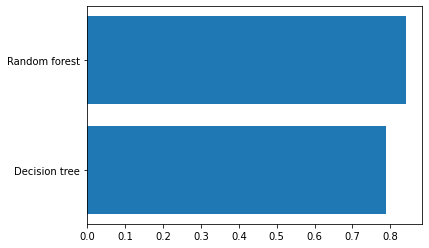

In [81]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)

[Text(0, 0.5, 'Machine learning model used'),
 (0.0, 1.0),
 Text(0.5, 0, 'Accuracy percentage'),
 Text(0.5, 1.0, 'Model accuracy applied on Big data analytics')]

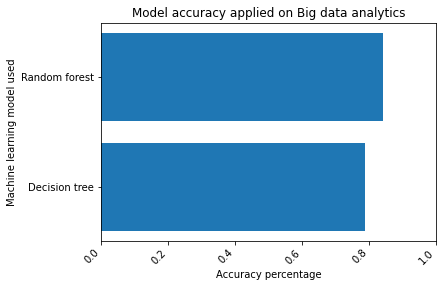

In [82]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)
labels = ax.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
ax.set(xlim=[0, 1], xlabel='Accuracy percentage', ylabel='Machine learning model used',
       title='Model accuracy applied on Big data analytics')

In [83]:
import matplotlib.pyplot as plt
import pandas as pd

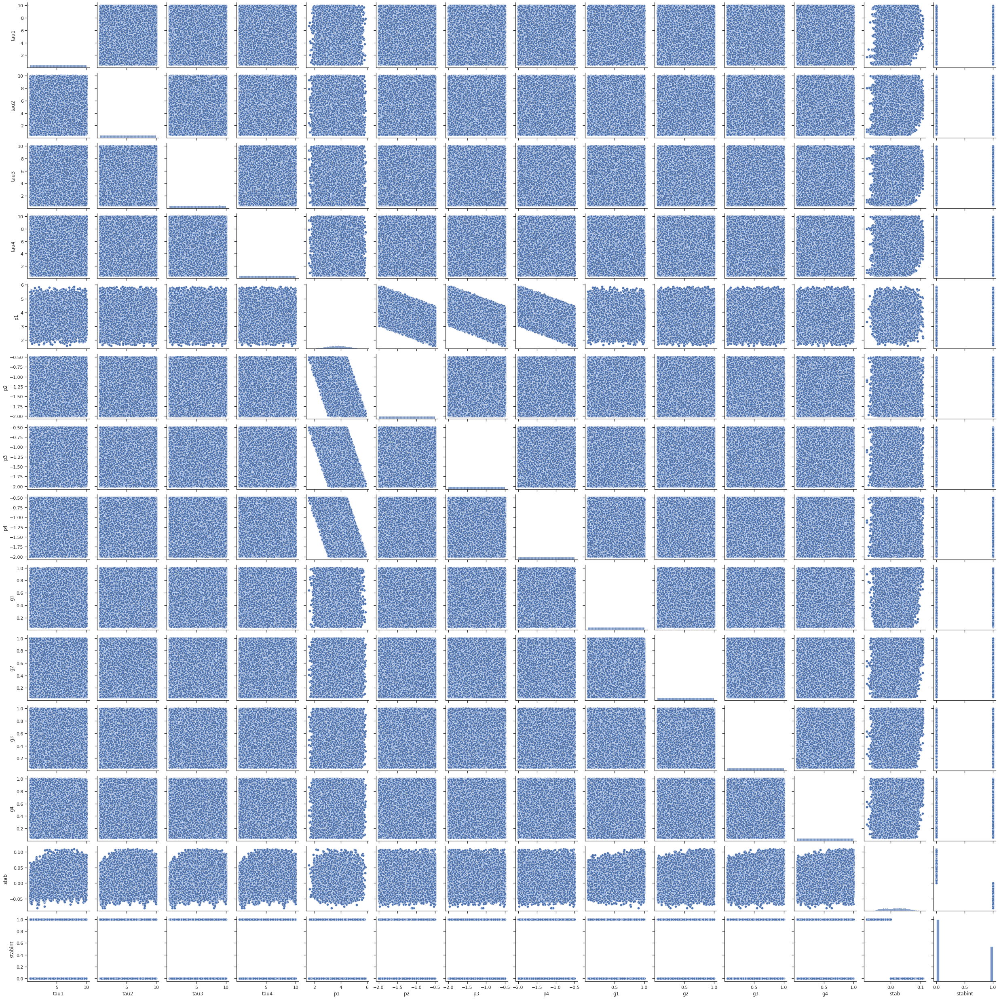

In [84]:
import seaborn as sns
sns.set(style="ticks")

sns.pairplot(v_grid_df2.toPandas())
plt.show()

In [85]:
vgrid_df2 = v_grid_df2.select(['features', 'stabint'])

RMS Error                      alpha
0.035889051154989256 1.0
0.030610543534671526 0.1
0.022740996808788837 0.010000000000000002
0.021946032507331903 0.0010000000000000002
0.02194088169528828 0.00010000000000000002
0.021941584004700997 1.0000000000000003e-05
0.02194166705877259 1.0000000000000004e-06


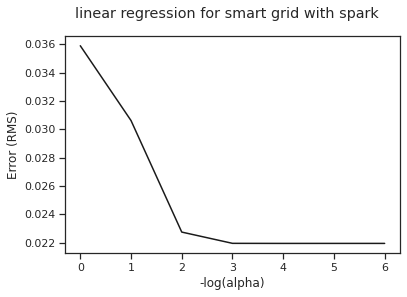

In [86]:
splits = vgrid_df.randomSplit([0.60, 0.4])
xTrain_sp = splits[0]
xTest_sp = splits[1]
alphaList = [0.1**i for i in [0,1, 2, 3, 4, 5, 6]]
rmsError = []
for alph in alphaList:
  grid_ridge_sp = LinearRegression(featuresCol = 'features', \
                                  labelCol='stab', maxIter=100, regParam=alph, \
                                  elasticNetParam=0.0)
  grid_ridge_sp_model = grid_ridge_sp.fit(xTrain_sp)
  test_result = grid_ridge_sp_model.evaluate(xTest_sp)
  rmsError.append(test_result.rootMeanSquaredError)
print('{:30}'.format("RMS Error"), "alpha")
for i in range(len(rmsError)):
 print(rmsError[i], alphaList[i])
#plot curve of out-of-sample error versus alpha
x = range(len(rmsError))
plt.plot(x, rmsError, 'k')
plt.xlabel('-log(alpha)')
plt.ylabel('Error (RMS)')
plt.suptitle('linear regression for smart grid with spark')
plt.savefig('linear_regression_for_smart_grid_with_spark.png', dpi=500)
plt.show()

In [87]:
from pyspark.ml.classification import MultilayerPerceptronClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Load training data
data = vgrid_df2
data = data.withColumnRenamed('stabint', 'label')
# Split the data into train and test
splits = data.randomSplit([0.6, 0.4], 1234)
train = splits[0]
test = splits[1]

# specify layers for the neural network:
# input layer of size 12 (features), two intermediate of size 5 and 4
# and output of size 2 (classes)
layers = [12, 5, 4, 2]

# create the trainer and set its parameters
trainer = MultilayerPerceptronClassifier(maxIter=100, layers=layers, blockSize=128, seed=1234)

# train the model
model = trainer.fit(train)

# compute accuracy on the test set
result = model.transform(test)
predictionAndLabels = result.select("prediction", "label")
evaluator = MulticlassClassificationEvaluator(metricName="accuracy")
print("Test set accuracy = " + str(evaluator.evaluate(predictionAndLabels)))

Test set accuracy = 0.870828490785323


In [88]:
train_output_df = model.transform(train)
test_output_df = model.transform(test)

In [89]:

train_predictionAndLabels = train_output_df.select('prediction', 'label')
test_predictionAndLabels = test_output_df.select('prediction', 'label')

In [90]:
metrics = ['weightedPrecision', 'weightedRecall', 'accuracy']
for metric in metrics:
  evaluator = MulticlassClassificationEvaluator(metricName=metric)
  print('Train ' + metric + ' = ' + str(evaluator.evaluate(
      train_predictionAndLabels)))
  print('Test ' + metric + ' = ' + str(evaluator.evaluate(
      test_predictionAndLabels)))

Train weightedPrecision = 0.8695554733149435
Test weightedPrecision = 0.8707588709228258
Train weightedRecall = 0.8695833797482455
Test weightedRecall = 0.870828490785323
Train accuracy = 0.8695833797482455
Test accuracy = 0.870828490785323


In [91]:
import numpy as np
import matplotlib.pyplot as plt


data = {'Decision tree': 0.78912,
        'Random forest': 0.8413816230717639,
        'Deep learning': 0.8708699983396978}
group_data = list(data.values())
group_names = list(data.keys())
group_mean = np.mean(group_data)

<BarContainer object of 3 artists>

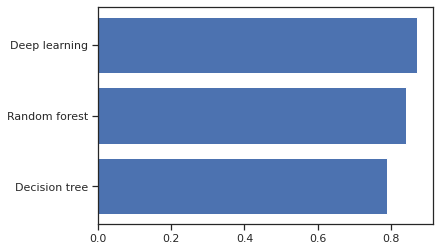

In [92]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)

[Text(0, 0.5, 'Machine learning model used'),
 (0.0, 1.0),
 Text(0.5, 0, 'Accuracy percentage'),
 Text(0.5, 1.0, 'Model accuracy applied on Big data analytics')]

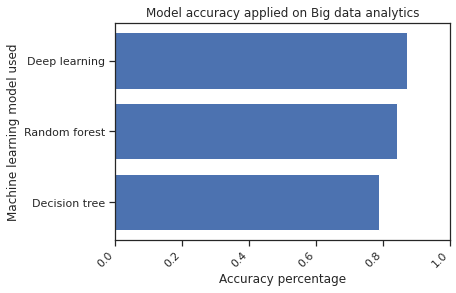

In [93]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)
labels = ax.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
ax.set(xlim=[0, 1], xlabel='Accuracy percentage', ylabel='Machine learning model used',
       title='Model accuracy applied on Big data analytics')

In [94]:
import numpy as np
import matplotlib.pyplot as plt


data = {'Decision tree': 7,
        'Random forest': 10,
        'Deep learning': 4}
group_data = list(data.values())
group_names = list(data.keys())
group_mean = np.mean(group_data)

<BarContainer object of 3 artists>

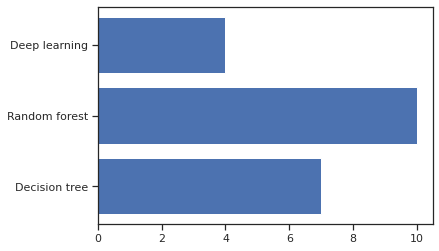

In [95]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)

[Text(0, 0.5, 'Machine learning model used'),
 (0.0, 1.0),
 Text(0.5, 0, 'Accuracy percentage'),
 Text(0.5, 1.0, 'Model accuracy applied on Big data analytics')]

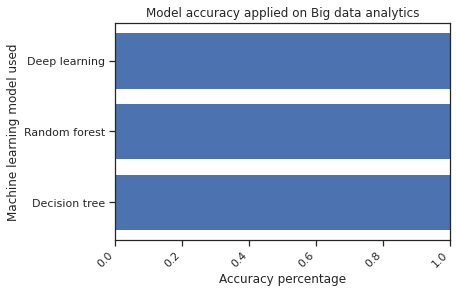

In [96]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)
labels = ax.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
ax.set(xlim=[0, 1], xlabel='Accuracy percentage', ylabel='Machine learning model used',
       title='Model accuracy applied on Big data analytics')

[Text(0, 0.5, 'Machine learning model used'),
 (0.0, 10.0),
 Text(0.5, 0, 'Run Timing in seconds '),
 Text(0.5, 1.0, 'Run time for the applied Big data analytics on decentralized smart grid system')]

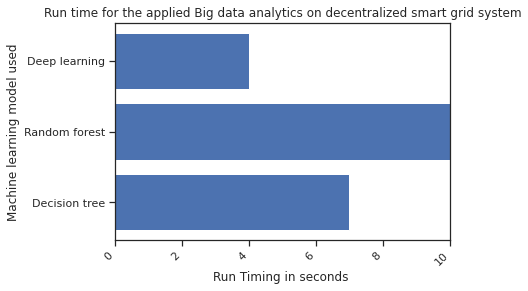

In [97]:
fig, ax = plt.subplots()
ax.barh(group_names, group_data)
labels = ax.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
ax.set(xlim=[0, 10], xlabel='Run Timing in seconds ', ylabel='Machine learning model used',
       title='Run time for the applied Big data analytics on decentralized smart grid system')